In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from nltk.corpus import stopwords
import re
from wordcloud import WordCloud

In [2]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Embedding, LSTM, Conv1D, MaxPool1D, Dropout
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score
from sklearn import preprocessing
from tensorflow.keras.initializers import Initializer
import tensorflow as tf

In [3]:
pd.read_csv('indian_fake_news.csv')

,label,text
0,REAL,Payal has accused filmmaker Anurag Kashyap of ...
1,FAKE,A four-minute-long video of a woman criticisin...
2,FAKE,"Republic Poll, a fake Twitter account imitatin..."
3,REAL,"Delhi teen finds place on UN green list, turns..."
4,REAL,Delhi: A high-level meeting underway at reside...
...,...,...
3724,REAL,19:17 (IST) Sep 20\n\nThe second round of coun...
3725,REAL,19:17 (IST) Sep 20\n\nThe second round of coun...
3726,FAKE,The Bengaluru City Police’s official Twitter h...
3727,REAL,"Sep 20, 2020, 08:00AM IST\n\nSource: TOI.in\n\..."


In [4]:
data = pd.read_csv('indian_fake_news.csv')

In [5]:
data['label'].value_counts()

label
FAKE    1877
REAL    1852
Name: count, dtype: int64

In [6]:
fake_news = []
real_news = []
text = data['text'].tolist()
label = data['label'].tolist()
cnt = 0
for i in label:
    #print(i)
    if i == 'FAKE':
        #print(cnt, i)
        fake_news.append(text[cnt])
    elif i == 'REAL':
        real_news.append(text[cnt])
    cnt = cnt +1

In [7]:
fake_news

['A four-minute-long video of a woman criticising the government at an anti-Citizenship Amendment Act rally in Delhi earlier in January is going viral with a false claim that the woman shows late Prime Minister Atal Bihari Vajpayee\'s niece.\n\nThe caption in Hindi translates to: " Respected Vajpayee ji\'s niece has finally broken her silence, listen to what she has to say."\n\n\n\n(Translated from Hindi: माननीय वाजपयी जी की भतीजी ने आखिरकार तोड़ी चुप्पी | जानिए क्या कहा)\n\nAlso Read: Muslim Politician Disguised As A Hindu In Anti-CAA Protests?\n\nThe video comes at a time when protests against the Citizenship Amendment Act and a proposed National Register of Citizens have gone unabated for over a month.\n\nIn the video, the woman can be seen saying the following in Hindi.\n\n"They (Britishers) did a lot of bad but at least they were outsiders. First of all, they were not ours, they were not from this land. They came from afar and came here to do this. But still, the difference betwee

In [8]:
real_news

['Payal has accused filmmaker Anurag Kashyap of behaving inappropriately with her in a video that went viral. She maintained her stance while speaking to ETimes and said, “I have wanted to speak about this for a long time. But today, finally I thought I must get it off my head. I had tweeted about my incident sometime ago when the #MeToo movement had happened, but many people told me to delete the tweet else I would stop getting work. My manager too advised me to remove the tweet. I complied. Post that, Anurag blocked me on WhatsApp.”',
 'Delhi teen finds place on UN green list, turns glass into sand\n\nNEW DELHI: Udit Singhal , who founded a startup to turn glass bottles into sand , has been named among 17 people in the United Nation’s 2020 Class of Young Leaders for Sustainable Development Goals (SDGs). The programme is a flagship initiative that recognises the efforts of young people in driving action and galvanising others in support of UN’s 2030 agenda for sustainable development.

# Real News 

In [9]:
rtext = "".join(str(real_news))
rtext

'[\'Payal has accused filmmaker Anurag Kashyap of behaving inappropriately with her in a video that went viral. She maintained her stance while speaking to ETimes and said, “I have wanted to speak about this for a long time. But today, finally I thought I must get it off my head. I had tweeted about my incident sometime ago when the #MeToo movement had happened, but many people told me to delete the tweet else I would stop getting work. My manager too advised me to remove the tweet. I complied. Post that, Anurag blocked me on WhatsApp.”\', \'Delhi teen finds place on UN green list, turns glass into sand\\n\\nNEW DELHI: Udit Singhal , who founded a startup to turn glass bottles into sand , has been named among 17 people in the United Nation’s 2020 Class of Young Leaders for Sustainable Development Goals (SDGs). The programme is a flagship initiative that recognises the efforts of young people in driving action and galvanising others in support of UN’s 2030 agenda for sustainable develop

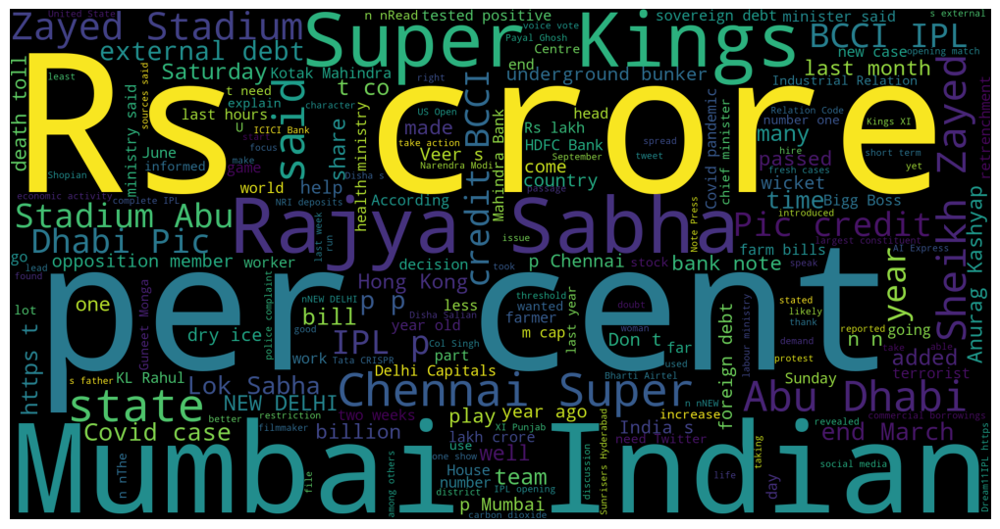

In [10]:
wordcloud = WordCloud(width=1920, height = 1000).generate(rtext)
fig = plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show()

In [11]:
ftext = "".join(str(fake_news))
ftext = ftext.replace("\n", " ")
ftext = ftext.replace("\\n", " ")
ftext = ftext.replace("\ ", " ")
ftext = ftext.replace("\\", " ")
ftext

'[\'A four-minute-long video of a woman criticising the government at an anti-Citizenship Amendment Act rally in Delhi earlier in January is going viral with a false claim that the woman shows late Prime Minister Atal Bihari Vajpayee \'s niece.  The caption in Hindi translates to: " Respected Vajpayee ji \'s niece has finally broken her silence, listen to what she has to say."    (Translated from Hindi: माननीय वाजपयी जी की भतीजी ने आखिरकार तोड़ी चुप्पी | जानिए क्या कहा)  Also Read: Muslim Politician Disguised As A Hindu In Anti-CAA Protests?  The video comes at a time when protests against the Citizenship Amendment Act and a proposed National Register of Citizens have gone unabated for over a month.  In the video, the woman can be seen saying the following in Hindi.  "They (Britishers) did a lot of bad but at least they were outsiders. First of all, they were not ours, they were not from this land. They came from afar and came here to do this. But still, the difference between them (In

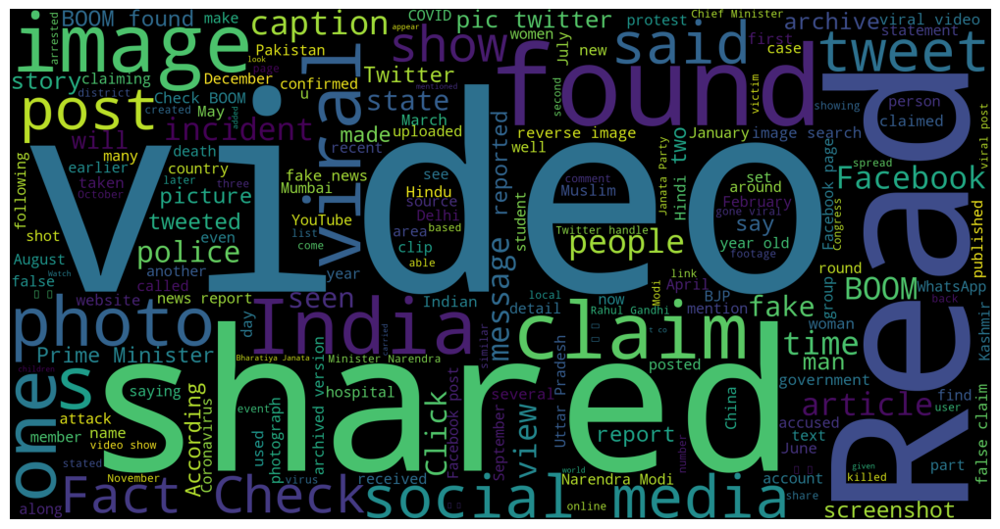

In [12]:
wordcloud = WordCloud(width=1920, height = 1000).generate(ftext)
fig = plt.figure(figsize=(10,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad = 0)
plt.show()

In [13]:
len(data[data['text'].isnull()==True])

8

In [14]:
len(data[data['label'].isnull()==True])

0

In [15]:
data.dropna()

,label,text
0,REAL,Payal has accused filmmaker Anurag Kashyap of ...
1,FAKE,A four-minute-long video of a woman criticisin...
2,FAKE,"Republic Poll, a fake Twitter account imitatin..."
3,REAL,"Delhi teen finds place on UN green list, turns..."
4,REAL,Delhi: A high-level meeting underway at reside...
...,...,...
3724,REAL,19:17 (IST) Sep 20\n\nThe second round of coun...
3725,REAL,19:17 (IST) Sep 20\n\nThe second round of coun...
3726,FAKE,The Bengaluru City Police’s official Twitter h...
3727,REAL,"Sep 20, 2020, 08:00AM IST\n\nSource: TOI.in\n\..."


In [16]:
data['clean_text'] = data['text'].str.lower()
data['clean_text']

0       payal has accused filmmaker anurag kashyap of ...
1       a four-minute-long video of a woman criticisin...
2       republic poll, a fake twitter account imitatin...
3       delhi teen finds place on un green list, turns...
4       delhi: a high-level meeting underway at reside...
                              ...                        
3724    19:17 (ist) sep 20\n\nthe second round of coun...
3725    19:17 (ist) sep 20\n\nthe second round of coun...
3726    the bengaluru city police’s official twitter h...
3727    sep 20, 2020, 08:00am ist\n\nsource: toi.in\n\...
3728    read also\n\nread also\n\nadvocate ishkaran bh...
Name: clean_text, Length: 3729, dtype: object

In [17]:
data['clean_text'] = data['clean_text'].str.replace('[A-Za-z0-9\s]','')
data['clean_text'] = data['clean_text'].str.replace('\n',' ')
data['clean_text'] = data['clean_text'].str.replace('\s+',' ')
data['clean_text'] = data['clean_text'].str.replace('\\','')
data['clean_text']

0       payal has accused filmmaker anurag kashyap of ...
1       a four-minute-long video of a woman criticisin...
2       republic poll, a fake twitter account imitatin...
3       delhi teen finds place on un green list, turns...
4       delhi: a high-level meeting underway at reside...
                              ...                        
3724    19:17 (ist) sep 20  the second round of countr...
3725    19:17 (ist) sep 20  the second round of countr...
3726    the bengaluru city police’s official twitter h...
3727    sep 20, 2020, 08:00am ist  source: toi.in  mee...
3728    read also  read also  advocate ishkaran bhanda...
Name: clean_text, Length: 3729, dtype: object

In [18]:
nltk.download('stopwords')
stop = stopwords.words('english')
data['clean_text'] = data['clean_text'].apply(lambda x: " ".join([word for word in str(x).split() if word not in stop]))
data.head()

[nltk_data] Error loading stopwords: <urlopen error [SSL:
[nltk_data]     CERTIFICATE_VERIFY_FAILED] certificate verify failed:
[nltk_data]     self-signed certificate in certificate chain
[nltk_data]     (_ssl.c:1006)>


,label,text,clean_text
0,REAL,Payal has accused filmmaker Anurag Kashyap of ...,payal accused filmmaker anurag kashyap behavin...
1,FAKE,A four-minute-long video of a woman criticisin...,four-minute-long video woman criticising gover...
2,FAKE,"Republic Poll, a fake Twitter account imitatin...","republic poll, fake twitter account imitating ..."
3,REAL,"Delhi teen finds place on UN green list, turns...","delhi teen finds place un green list, turns gl..."
4,REAL,Delhi: A high-level meeting underway at reside...,delhi: high-level meeting underway residence r...


In [19]:
data['clean_text'].tolist()

['payal accused filmmaker anurag kashyap behaving inappropriately video went viral. maintained stance speaking etimes said, “i wanted speak long time. today, finally thought must get head. tweeted incident sometime ago #metoo movement happened, many people told delete tweet else would stop getting work. manager advised remove tweet. complied. post that, anurag blocked whatsapp.”',
 'four-minute-long video woman criticising government anti-citizenship amendment act rally delhi earlier january going viral false claim woman shows late prime minister atal bihari vajpayee\'s niece. caption hindi translates to: " respected vajpayee ji\'s niece finally broken silence, listen say." (translated hindi: माननीय वाजपयी जी की भतीजी ने आखिरकार तोड़ी चुप्पी | जानिए क्या कहा) also read: muslim politician disguised hindu anti-caa protests? video comes time protests citizenship amendment act proposed national register citizens gone unabated month. video, woman seen saying following hindi. "they (britishe

In [20]:
data['text'].tolist()

['Payal has accused filmmaker Anurag Kashyap of behaving inappropriately with her in a video that went viral. She maintained her stance while speaking to ETimes and said, “I have wanted to speak about this for a long time. But today, finally I thought I must get it off my head. I had tweeted about my incident sometime ago when the #MeToo movement had happened, but many people told me to delete the tweet else I would stop getting work. My manager too advised me to remove the tweet. I complied. Post that, Anurag blocked me on WhatsApp.”',
 'A four-minute-long video of a woman criticising the government at an anti-Citizenship Amendment Act rally in Delhi earlier in January is going viral with a false claim that the woman shows late Prime Minister Atal Bihari Vajpayee\'s niece.\n\nThe caption in Hindi translates to: " Respected Vajpayee ji\'s niece has finally broken her silence, listen to what she has to say."\n\n\n\n(Translated from Hindi: माननीय वाजपयी जी की भतीजी ने आखिरकार तोड़ी चुप्प

## Word Embeddings

In [21]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(data['clean_text'])
word_index = tokenizer.word_index
vocab_size = len(word_index)
vocab_size

49593

In [22]:
# Padding 
sequences = tokenizer.texts_to_sequences(data['clean_text'])
padded_seq = pad_sequences(sequences, maxlen=500, padding='post', truncating='post')

In [23]:
padded_seq

array([[  521,   292,   511, ...,     0,     0,     0],
       [  207,   720,   236, ...,     0,     0,     0],
       [ 1216,  2359,    23, ...,     0,     0,     0],
       ...,
       [ 2118,   426, 15266, ...,     0,     0,     0],
       [ 3232,   137,    13, ...,     0,     0,     0],
       [   19,     2,    19, ...,     0,     0,     0]])

In [24]:
# Creating embedding index
embedding_index = {}
with open('glove.6B.100d.txt', encoding='utf-8') as f:
    for line in f:
        values = line.split()
        word = values[0]
        coefs = np.asarray(values[1:], dtype='float32')
        embedding_index[word] = coefs

In [25]:
# Create embedding matrix
embedding_matrix = np.zeros((vocab_size + 1, 100))
for word,i in word_index.items():
    embedding_vector = embedding_index.get(word)
    if embedding_vector is not None:
        embedding_matrix[i] = embedding_vector

In [26]:
embedding_matrix[1]

array([ 0.10034   , -0.38488999,  0.24913   , -0.62181997,  1.22940004,
        0.36001   ,  0.097876  ,  0.14494   ,  0.47424001,  0.12673999,
        0.73139   , -0.58911002,  0.038377  , -0.67777997,  0.54821998,
        0.93437999,  0.41648   , -0.12182   ,  0.15790001,  0.65072   ,
        0.040747  , -0.69006997,  0.47016999,  0.014909  ,  0.2473    ,
        0.22634999,  0.56367999,  0.7823    ,  0.13036001,  0.83881998,
        0.39655   ,  0.47156   , -0.71565998,  0.97965997,  1.00479996,
       -0.012945  , -0.63141   ,  0.20152   ,  0.094097  , -0.99601001,
        0.41981   ,  0.36629999, -0.49478999,  0.85229999, -0.3951    ,
       -0.37663999, -0.67062998, -0.66297001,  0.81449997, -0.4718    ,
       -0.03941   ,  0.15981001,  0.23669   ,  0.94268   ,  0.51783001,
       -2.61949992, -0.46807   , -0.023804  ,  1.54579997,  0.31018001,
       -0.23875   ,  1.11580002,  0.16737001, -0.49857   ,  0.22240999,
        0.40138999,  0.72921002,  0.23118   , -0.26800999,  0.54

In [27]:
padded_seq[1]

array([  207,   720,   236,     1,   136,  6604,    24,   375,   882,
         718,   438,   608,    28,   162,   387,   182,     5,    75,
          48,   136,    91,   538,   159,    29,  6605,  7195, 10102,
        6459,    53,   117,   837,   614,  7441,  8072, 15629,  6459,
         997,  3922,  7196,  3886,   541,   795,   117, 15630, 25789,
        2061,   277, 25790,   827, 25791, 25792, 25793, 25794,  2426,
        6606,     2,    19,   293,  2207,  6460,   282,   375,   737,
         310,     1,   481,    32,   310,   882,   718,   438,   859,
         152,  3325,  1672,   440, 15631,   263,     1,   136,    79,
         233,   251,   117,  1120, 13494,   722,  1391,   395, 12026,
          40,   810, 10103,   845,   330, 25795,   330,   213,   360,
        1026,    33,    24, 13494, 13494,  7746, 10900,   395, 13494,
          24,    20,  1357,  1498,    33,  2497,     9,  2469,    64,
        2469,   372,  2469,    47,  5773,    94,  9450,  2497,    94,
        1622,  2497,

# Model

In [28]:
label_encoder = preprocessing.LabelEncoder() 
data['label']= label_encoder.fit_transform(data['label'])
data

,label,text,clean_text
0,1,Payal has accused filmmaker Anurag Kashyap of ...,payal accused filmmaker anurag kashyap behavin...
1,0,A four-minute-long video of a woman criticisin...,four-minute-long video woman criticising gover...
2,0,"Republic Poll, a fake Twitter account imitatin...","republic poll, fake twitter account imitating ..."
3,1,"Delhi teen finds place on UN green list, turns...","delhi teen finds place un green list, turns gl..."
4,1,Delhi: A high-level meeting underway at reside...,delhi: high-level meeting underway residence r...
...,...,...,...
3724,1,19:17 (IST) Sep 20\n\nThe second round of coun...,19:17 (ist) sep 20 second round countrywide se...
3725,1,19:17 (IST) Sep 20\n\nThe second round of coun...,19:17 (ist) sep 20 second round countrywide se...
3726,0,The Bengaluru City Police’s official Twitter h...,bengaluru city police’s official twitter handl...
3727,1,"Sep 20, 2020, 08:00AM IST\n\nSource: TOI.in\n\...","sep 20, 2020, 08:00am ist source: toi.in meet ..."


In [36]:
x_train, x_test, y_train, y_test = train_test_split(padded_seq, data['label'], test_size=0.20, random_state=42, stratify=data['label'])

In [37]:
x_train

array([[ 815, 1521, 9513, ...,    0,    0,    0],
       [   1,  214,  439, ...,    0,    0,    0],
       [ 211,  207,  144, ...,    0,    0,    0],
       ...,
       [  19,    2,   19, ...,    0,    0,    0],
       [ 110,    9,  101, ...,    0,    0,    0],
       [  23,   15,  151, ...,    0,    0,    0]])

In [48]:
class CustomEmbeddingInitializer(Initializer):
    def __init__(self, embedding_weights):
        self.embedding_weights = embedding_weights

    def __call__(self, shape, dtype=None):
        #assert len(shape) == 2, "Shape should be 2D"
        #assert shape[1] == len(self.embedding_weights[0]), "Mismatch in embedding dimension"
        #return tf.Variable(self.embedding_weights, dtype=dtype, trainable=False)
        return self.embedding_weights
embedding_weights = embedding_matrix
custom_initializer = CustomEmbeddingInitializer(embedding_weights)
custom_initializer

In [55]:
model = Sequential([
    Embedding(vocab_size+1, output_dim=100, embeddings_initializer=custom_initializer, trainable=False),
    #Embedding(vocab_size+1, output_dim=100,  trainable=True),
    #Dropout(0.2),
    #LSTM(128, return_sequences=True),
    LSTM(units=128),
    #Dense(512, activation='relu'),
    #Dropout(0.2),
    Dense(256, activation='relu'),
    Dense(1, activation='sigmoid')
])

In [56]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_6 (Embedding)              │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_8 (LSTM)                        │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [57]:
history = model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=[x_test, y_test])

Epoch 1/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.5205 - loss: 0.6836 - val_accuracy: 0.5550 - val_loss: 0.6248
Epoch 2/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.5218 - loss: 0.6494 - val_accuracy: 0.5509 - val_loss: 0.6302
Epoch 3/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.5525 - loss: 0.6506 - val_accuracy: 0.5496 - val_loss: 0.6294
Epoch 4/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.5408 - loss: 0.6409 - val_accuracy: 0.5483 - val_loss: 0.6388
Epoch 5/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.5543 - loss: 0.6679 - val_accuracy: 0.5416 - val_loss: 0.6526
Epoch 6/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.5397 - loss: 0.6488 - val_accuracy: 0.5536 - val_loss: 0.6291
Epoch 7/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.5596 - loss: 0.6430 - val_accuracy: 0.5523 - val_loss: 0.6293
Epoch 8/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.5380 - loss: 0.6455 - val_accuracy: 0.5523 - val_loss:

# Different approch

In [58]:
from nltk.stem.porter import PorterStemmer

In [59]:
port_stem = PorterStemmer()

In [60]:
port_stem

<PorterStemmer>

In [61]:
port_stem.stem("hi this is chandu")

'hi this is chandu'

In [79]:
def stemming(content):
    con =  re.sub('[^a-zA-Z]', ' ', str(content))
    con = con.lower()
    con = con.split()
    con = [port_stem.stem(word) for word in con if not word in stopwords.words('english')]
    con = ' '.join(con)
    return con

In [80]:
stemming('Hi 1 This \nis \nchando')

'hi chando'

In [81]:
"This6".lower()

'this6'

In [82]:
data['clean_text2'] = data['text'].apply(stemming)

In [83]:
data

,label,text,clean_text,clean_text2
0,1,Payal has accused filmmaker Anurag Kashyap of ...,payal accused filmmaker anurag kashyap behavin...,payal accus filmmak anurag kashyap behav inapp...
1,0,A four-minute-long video of a woman criticisin...,four-minute-long video woman criticising gover...,four minut long video woman criticis govern an...
2,0,"Republic Poll, a fake Twitter account imitatin...","republic poll, fake twitter account imitating ...",republ poll fake twitter account imit arnab go...
3,1,"Delhi teen finds place on UN green list, turns...","delhi teen finds place un green list, turns gl...",delhi teen find place un green list turn glass...
4,1,Delhi: A high-level meeting underway at reside...,delhi: high-level meeting underway residence r...,delhi high level meet underway resid rajya sab...
...,...,...,...,...
3724,1,19:17 (IST) Sep 20\n\nThe second round of coun...,19:17 (ist) sep 20 second round countrywide se...,ist sep second round countrywid serosurvey led...
3725,1,19:17 (IST) Sep 20\n\nThe second round of coun...,19:17 (ist) sep 20 second round countrywide se...,ist sep second round countrywid serosurvey led...
3726,0,The Bengaluru City Police’s official Twitter h...,bengaluru city police’s official twitter handl...,bengaluru citi polic offici twitter handl mond...
3727,1,"Sep 20, 2020, 08:00AM IST\n\nSource: TOI.in\n\...","sep 20, 2020, 08:00am ist source: toi.in meet ...",sep ist sourc toi meet neelkantha bhanu prakas...


In [84]:
x = data['clean_text2']
y = data['label']

In [85]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [87]:
vect = TfidfVectorizer()

In [97]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)

In [98]:
x_train = vect.fit_transform(x_train)
x_test = vect.transform(x_test)

In [99]:
x_train.shape

(2983, 23165)

In [100]:
x_test.shape

(746, 23165)

In [101]:
from sklearn.tree import DecisionTreeClassifier

In [102]:
model = DecisionTreeClassifier()
model.fit(x_train, y_train)

DecisionTreeClassifier()

In [103]:
prediction = model.predict(x_test)
model.score(x_test, y_test)

0.985254691689008

In [104]:
prediction

array([0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0,
       1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0,
       1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1,
       1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1,
       0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0,
       1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0,
       1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1,
       1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0,

## storing data

In [106]:
import pickle
pickle.dump(vect, open('vector.pkl', 'wb'))
pickle.dump(model, open('model.pkl', 'wb'))

## Loading data

In [107]:
vector_form = pickle.load(open('vector.pkl', 'rb'))
model_load = pickle.load(open('model.pkl', 'rb'))

In [108]:
def check_fake(news):
    news = stemming(news)
    input_data = [news]
    vector = vector_form.transform(input_data)
    prediction = model_load.predict(vector)
    if prediction == 1:
        print("Real news")
    elif prediction == 0:
        print("Fake news")

In [109]:
check_fake("""A viral post insinuating that 96% of rapists in India belong to the Muslim community, is false and not supported by official data



The post, which refers to a fictitious statistic claims that between 2016 - 2018, there were 84,374 rapes in India, out of which, 81,000 were Muslim perpetrators.

India's National Crime Records Bureau (NCRB), under the the Ministry of Home Affairs, has not released crime data for 2018 in the first place, rendering these numbers questionable. Furthermore, NCRB does not collect data or provide a break up of rape statistics on the basis of religion of either the victim or the rapist.



The misleading Facebook post lies the confluence of the gang rape of a 26 year old veterinary doctor that took place in Hyderabad on November 27, speculation around potential hanging of the Nirbhaya gangrape perpetrators and the anti-Muslim rhetoric drummed up since the passage of the Citizenship Amendment Bill in Parliament this week. The government has also been facing questions over growing crimes against women in Lok Sabha.



The post by Facebook user 'Vedic Science' cited a tweet from one Prof. Hari Om (@DostKhan_Jammu), a screenshot of which can be seen below.









An archived version of this post can be seen here.



On tracing the Hari Om's Twitter profile, we found two tweets claiming these figures. His tweets carry Postcard News as its source, and it also carries the coverage carried out by Swarajyamag on the Hyderabad gangrape case. However, Swarajyamag's coverage does not carry these numbers.

















On looking further, BOOM found similar numbers being claimed as far back as 2018.









An archived version of this tweet can be found here.



FactCheck



Data from the NCRB for calendar year 2018 has not been released, since data for 2017 was released in October this year - after a delay of one year. The data being cited is from the NCRB's flagship 'Crime In India' report, which is usually released annually and contains a whole set of comprehensive crime statistics in India.



Data from NCRB's 2016 and 2017 report shows a total of 71,506 incidents of rape and 72,726 victims of rape counting both these reports, counting cases that have been registered under section 376 of the Indian Penal Code. The year-wise breakdown can be found below.









Further, there is no evidence on the religions of either the victims of rape or the rapists, shows official data. The NCRB does not collect such data in the first place, as can be seen in its data set. The NCRB provides the following data on the offenders of rape:

The relation of the offender to the victim, to show that 93% of rapes were committed by offenders known to the victims The cases rape registered, under various sub-sections of section 376 of the Indian Penal Code







Here are some screenshots from the data set from 'Crime In India' that shows its headers. The picture below shows the cases and victims of rape by relation.









This picture shows the cases of rape registered.

















None of the data points point towards the fact that the victims of rape were primarily Hindu, or the offenders Muslim.





NCRB's 2017 report can be found here, and its 2016 report can be found here.



BOOM had debunked similar claims back in 2018 too.











""")

Fake news
